# Load Dataset

In [ ]:
!pip install -q datasets
!pip install Pillow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 14.1 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.


In [ ]:
from google.colab import drive
drive.mount("/content/drive", force_remount=True)
path="/content/drive/MyDrive/Datasets"
import cv2
import pickle
import os

Mounted at /content/drive


In [ ]:
from datasets import load_dataset

# Define the local path to the downloaded dataset file
data_folder = "/content/drive/MyDrive/My Research/Research_Paper_Watermalon_Disease/Watermelon/"

# Load the dataset
dataset = load_dataset(data_folder)

# Split the dataset into train and validation sets
train_val_split = dataset['train'].train_test_split(test_size=0.2, seed=42)

# Separate into train and validation datasets
train_dataset = train_val_split['train']
val_dataset = train_val_split['test']

# Print sizes of the splits
print(f"Train dataset size: {len(train_dataset)}")
print(f"Validation dataset size: {len(val_dataset)}")

# Verify dataset splits
print(train_dataset)
print(val_dataset)


Resolving data files:   0%|          | 0/803 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Train dataset size: 642
Validation dataset size: 161
Dataset({
    features: ['image', 'label'],
    num_rows: 642
})
Dataset({
    features: ['image', 'label'],
    num_rows: 161
})


In [ ]:
print(dataset["train"].features['label'].names)

['Anthracnose', 'Downy_Mildew', 'Healthy', 'Mosaic_Virus']


In [ ]:
selected_columns_names = ['Anthracnose', 'Downy_Mildew', 'Healthy', 'Mosaic_Virus']
selected_columns = [col for col in dataset["train"].features['label'].names if col in selected_columns_names]
print(selected_columns)

['Anthracnose', 'Downy_Mildew', 'Healthy', 'Mosaic_Virus']


In [ ]:
labels = selected_columns
num_labels = len(dataset["train"].features["label"].names)
label2id, id2label = dict(), dict()
for i, label in enumerate(labels):
    label2id[label] = i
    id2label[i] = label

print(label2id)
print(id2label)

{'Anthracnose': 0, 'Downy_Mildew': 1, 'Healthy': 2, 'Mosaic_Virus': 3}
{0: 'Anthracnose', 1: 'Downy_Mildew', 2: 'Healthy', 3: 'Mosaic_Virus'}


# Forward Pass ViT Model with a Toy Image

In [ ]:
import torch
import torch.nn as nn

# Create toy image with dim (batch x channel x width x height)
toy_img = torch.rand(1, 3, 48, 48)

# Define conv layer parameters
num_channels = 3
hidden_size = 768 #or emb_dimension
patch_size = 16

# Conv 2D layer
projection = nn.Conv2d(num_channels, hidden_size, kernel_size=patch_size,
             stride=patch_size)

# Forward pass toy img
out_projection = projection(toy_img)

print(f'Original image size: {toy_img.size()}')
print(f'Size after projection: {out_projection.size()}')

Original image size: torch.Size([1, 3, 48, 48])
Size after projection: torch.Size([1, 768, 3, 3])


In [ ]:
# Flatten the output after projection with Conv2D layer

patch_embeddings = out_projection.flatten(2).transpose(1, 2)
print(f'Patch embedding size: {patch_embeddings.size()}')

Patch embedding size: torch.Size([1, 9, 768])


In [ ]:
# Define [CLS] token embedding with the same emb dimension as the patches
batch_size = 1
cls_token = nn.Parameter(torch.randn(1, 1, hidden_size))
cls_tokens = cls_token.expand(batch_size, -1, -1)

# Prepend [CLS] token in the beginning of patch embedding
patch_embeddings = torch.cat((cls_tokens, patch_embeddings), dim=1)
print(f'Patch embedding size: {patch_embeddings.size()}')

Patch embedding size: torch.Size([1, 10, 768])


In [ ]:
# Define position embedding with the same dimension as the patch embedding
position_embeddings = nn.Parameter(torch.randn(batch_size, 10, hidden_size))

# Add position embedding into patch embedding
input_embeddings = patch_embeddings + position_embeddings
print(f'Input embedding size: {input_embeddings.size()}')

Input embedding size: torch.Size([1, 10, 768])


In [ ]:
# Define parameters for ViT-base (example)
num_heads = 12
num_layers = 12

# Define Transformer encoders' stack
transformer_encoder_layer = nn.TransformerEncoderLayer(
           d_model=hidden_size, nhead=num_heads,
           dim_feedforward=int(hidden_size * 4),
           dropout=0.1)
transformer_encoder = nn.TransformerEncoder(
           encoder_layer=transformer_encoder_layer,
           num_layers=num_layers)

# Forward pass
output_embeddings = transformer_encoder(input_embeddings)
print(f' Output embedding size: {output_embeddings.size()}')

 Output embedding size: torch.Size([1, 10, 768])


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/transformer.py:379: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(


In [ ]:
!pip install transformers

from transformers import ViTModel

# Load pretrained model
model_checkpoint = 'google/vit-base-patch16-224-in21k'
model = ViTModel.from_pretrained(model_checkpoint, add_pooling_layer=False)

# Example input image
input_img = torch.rand(batch_size, num_channels, 224, 224)

# Forward pass input image
output_embedding = model(input_img)
print(output_embedding)
print(f"Ouput embedding size: {output_embedding['last_hidden_state'].size()}")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of the model checkpoint at google/vit-base-patch16-224-in21k were not used when initializing ViTModel: ['pooler.dense.bias', 'pooler.dense.weight']
- This IS expected if you are initializing ViTModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing ViTModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


BaseModelOutputWithPooling(last_hidden_state=tensor([[[ 0.0575, -0.2197,  0.0762,  ...,  0.2039,  0.0581, -0.3394],
         [ 0.2137, -0.0058,  0.0491,  ..., -0.1322,  0.1106, -0.0889],
         [ 0.0271, -0.2416, -0.0696,  ...,  0.1197,  0.3129, -0.2382],
         ...,
         [ 0.0444, -0.0934, -0.0323,  ..., -0.0244,  0.0518, -0.3302],
         [ 0.0088, -0.2656, -0.0095,  ...,  0.0832,  0.1603, -0.3565],
         [ 0.0203, -0.1439, -0.0796,  ...,  0.0413,  0.1510, -0.3294]]],
       grad_fn=<NativeLayerNormBackward0>), pooler_output=None, hidden_states=None, attentions=None)
Ouput embedding size: torch.Size([1, 197, 768])


In [ ]:
num_labels = 4

# Define linear classifier layer
classifier = nn.Linear(hidden_size, num_labels)

# Forward pass on the output embedding of [CLS] token
output_classification = classifier(output_embedding['last_hidden_state'][:, 0, :])
print(f"Output embedding size: {output_classification.size()}")

Output embedding size: torch.Size([1, 4])


# Fine Tuning ViT Impelementation

In [ ]:
import numpy as np
import torch
import cv2
import torch.nn as nn
from transformers import ViTModel, ViTConfig
from torchvision import transforms
from torch.optim import Adam
from torch.utils.data import DataLoader
from tqdm import tqdm

#Pretrained model checkpoint
model_checkpoint = 'google/vit-base-patch16-224-in21k'

In [ ]:
from torchvision import transforms
from torch.utils.data import Dataset

# Define the custom dataset
class ImageDataset(Dataset):
    def __init__(self, dataset):
        self.dataset = dataset
        self.transform = transforms.Compose([
            transforms.Resize((224, 224)),  # Resize images to 224x224
            transforms.ToTensor(),          # Convert PIL images to tensors
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])  # Normalize using ImageNet stats
        ])

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        image = item['image']
        label = item['label']
        image = self.transform(image)  # Apply transformations
        return image, label


In [ ]:
class ViT(nn.Module):

  def __init__(self, config=ViTConfig(), num_labels=5,
               model_checkpoint='google/vit-base-patch16-224-in21k'):

        super(ViT, self).__init__()

        self.vit = ViTModel.from_pretrained(model_checkpoint, add_pooling_layer=False)
        self.classifier = (
            nn.Linear(config.hidden_size, num_labels)
        )

  def forward(self, x):

    x = self.vit(x)['last_hidden_state']
    # Use the embedding of [CLS] token
    output = self.classifier(x[:, 0, :])

    return output

Some weights of the model checkpoint at google/vit-base-patch16-224-in21k were not used when initializing ViTModel: ['pooler.dense.bias', 'pooler.dense.weight']
- This IS expected if you are initializing ViTModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing ViTModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Epoch 1/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.02s/it]


Epoch 1/20 | Train Loss: 0.056, Train Accuracy: 0.928 | Val Loss: 0.016, Val Accuracy: 0.994


Epoch 2/20 - Validation: 100%|██████████| 21/21 [00:20<00:00,  1.01it/s]


Epoch 2/20 | Train Loss: 0.011, Train Accuracy: 0.998 | Val Loss: 0.010, Val Accuracy: 0.994


Epoch 3/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.02s/it]


Epoch 3/20 | Train Loss: 0.007, Train Accuracy: 0.998 | Val Loss: 0.007, Val Accuracy: 0.994


Epoch 4/20 - Validation: 100%|██████████| 21/21 [00:20<00:00,  1.01it/s]


Epoch 4/20 | Train Loss: 0.005, Train Accuracy: 1.000 | Val Loss: 0.006, Val Accuracy: 0.994


Epoch 5/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.01s/it]


Epoch 5/20 | Train Loss: 0.004, Train Accuracy: 1.000 | Val Loss: 0.005, Val Accuracy: 0.994


Epoch 6/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.03s/it]


Epoch 6/20 | Train Loss: 0.003, Train Accuracy: 1.000 | Val Loss: 0.004, Val Accuracy: 0.994


Epoch 7/20 - Validation: 100%|██████████| 21/21 [00:22<00:00,  1.09s/it]


Epoch 7/20 | Train Loss: 0.002, Train Accuracy: 1.000 | Val Loss: 0.003, Val Accuracy: 1.000


Epoch 8/20 - Validation: 100%|██████████| 21/21 [00:22<00:00,  1.09s/it]


Epoch 8/20 | Train Loss: 0.002, Train Accuracy: 1.000 | Val Loss: 0.003, Val Accuracy: 0.994


Epoch 9/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.02s/it]


Epoch 9/20 | Train Loss: 0.002, Train Accuracy: 1.000 | Val Loss: 0.002, Val Accuracy: 1.000


Epoch 10/20 - Validation: 100%|██████████| 21/21 [00:20<00:00,  1.00it/s]


Epoch 10/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.002, Val Accuracy: 1.000


Epoch 11/20 - Validation: 100%|██████████| 21/21 [00:20<00:00,  1.02it/s]


Epoch 11/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.002, Val Accuracy: 1.000


Epoch 12/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.02s/it]


Epoch 12/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.002, Val Accuracy: 1.000


Epoch 13/20 - Validation: 100%|██████████| 21/21 [00:22<00:00,  1.06s/it]


Epoch 13/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.001, Val Accuracy: 1.000


Epoch 14/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.01s/it]


Epoch 14/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.001, Val Accuracy: 1.000


Epoch 15/20 - Validation: 100%|██████████| 21/21 [00:20<00:00,  1.03it/s]


Epoch 15/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.001, Val Accuracy: 1.000


Epoch 16/20 - Validation: 100%|██████████| 21/21 [00:20<00:00,  1.02it/s]


Epoch 16/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.001, Val Accuracy: 1.000


Epoch 17/20 - Validation: 100%|██████████| 21/21 [00:20<00:00,  1.01it/s]


Epoch 17/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.001, Val Accuracy: 1.000


Epoch 18/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.01s/it]


Epoch 18/20 | Train Loss: 0.001, Train Accuracy: 1.000 | Val Loss: 0.001, Val Accuracy: 1.000


Epoch 19/20 - Validation: 100%|██████████| 21/21 [00:21<00:00,  1.02s/it]


Epoch 19/20 | Train Loss: 0.000, Train Accuracy: 1.000 | Val Loss: 0.001, Val Accuracy: 1.000


Epoch 20/20 - Validation: 100%|██████████| 21/21 [00:20<00:00,  1.02it/s]


Epoch 20/20 | Train Loss: 0.000, Train Accuracy: 1.000 | Val Loss: 0.001, Val Accuracy: 1.000


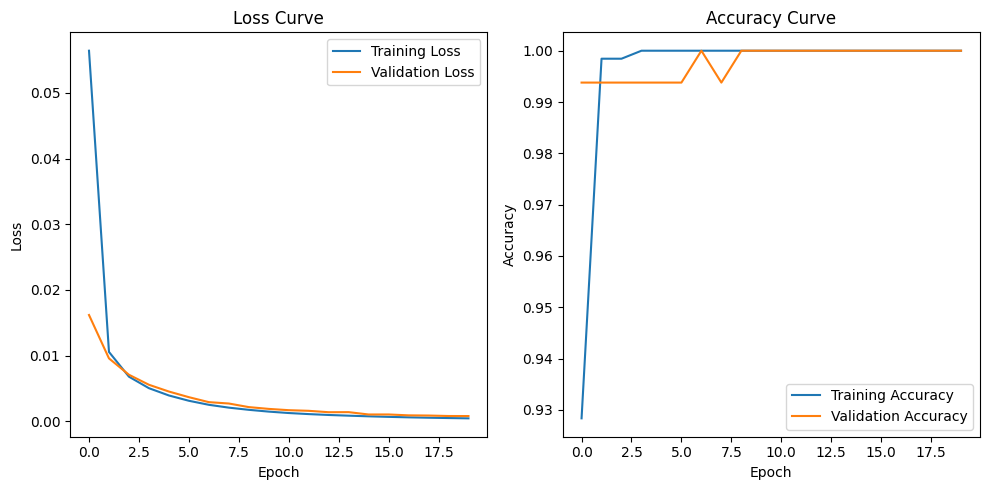

In [ ]:
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader
from tqdm import tqdm
import matplotlib.pyplot as plt

def model_train_and_validate(train_dataset, val_dataset, epochs, learning_rate, bs):
    use_cuda = torch.cuda.is_available()
    device = torch.device("cuda" if use_cuda else "cpu")

    # Load model, loss function, and optimizer
    model = ViT().to(device)
    criterion = nn.CrossEntropyLoss().to(device)
    optimizer = Adam(model.parameters(), lr=learning_rate)

    train_dataset = ImageDataset(train_dataset)
    val_dataset = ImageDataset(val_dataset)

    # Load data
    train_dataloader = DataLoader(train_dataset, num_workers=1, batch_size=bs, shuffle=True)
    val_dataloader = DataLoader(val_dataset, num_workers=1, batch_size=bs, shuffle=False)

    # Lists to store accuracy and loss for plotting
    train_loss_list, train_acc_list = [], []
    val_loss_list, val_acc_list = [], []

    # Training and validation loop
    for epoch in range(epochs):
        # Training phase
        model.train()
        total_acc_train, total_loss_train = 0, 0.0

        for train_image, train_label in tqdm(train_dataloader, desc=f"Epoch {epoch + 1}/{epochs} - Training"):
            output = model(train_image.to(device))

            loss = criterion(output, train_label.to(device))
            acc = (output.argmax(dim=1) == train_label.to(device)).sum().item()
            total_acc_train += acc
            total_loss_train += loss.item()

            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

        avg_loss_train = total_loss_train / len(train_dataset)
        avg_acc_train = total_acc_train / len(train_dataset)
        train_loss_list.append(avg_loss_train)
        train_acc_list.append(avg_acc_train)

        # Validation phase
        model.eval()
        total_acc_val, total_loss_val = 0, 0.0

        with torch.no_grad():
            for val_image, val_label in tqdm(val_dataloader, desc=f"Epoch {epoch + 1}/{epochs} - Validation"):
                output = model(val_image.to(device))
                loss = criterion(output, val_label.to(device))
                acc = (output.argmax(dim=1) == val_label.to(device)).sum().item()
                total_acc_val += acc
                total_loss_val += loss.item()

        avg_loss_val = total_loss_val / len(val_dataset)
        avg_acc_val = total_acc_val / len(val_dataset)
        val_loss_list.append(avg_loss_val)
        val_acc_list.append(avg_acc_val)

        # Print results for the epoch
        print(f"Epoch {epoch + 1}/{epochs} | "
              f"Train Loss: {avg_loss_train:.3f}, Train Accuracy: {avg_acc_train:.3f} | "
              f"Val Loss: {avg_loss_val:.3f}, Val Accuracy: {avg_acc_val:.3f}")

    # Plotting training and validation curves
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.plot(train_loss_list, label='Training Loss')
    plt.plot(val_loss_list, label='Validation Loss')
    plt.title('Loss Curve')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(train_acc_list, label='Training Accuracy')
    plt.plot(val_acc_list, label='Validation Accuracy')
    plt.title('Accuracy Curve')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

    return model


# Hyperparameters
EPOCHS = 20
LEARNING_RATE = 1e-4 / 2
BATCH_SIZE = 8

# Use the previously split datasets for training and validation
trained_model = model_train_and_validate(train_dataset, val_dataset, EPOCHS, LEARNING_RATE, BATCH_SIZE)


# Model Prediction

In [ ]:
def predict(img):

    use_cuda = torch.cuda.is_available()
    device = torch.device("cuda" if use_cuda else "cpu")
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize((224, 224)),
        transforms.Normalize(mean=[0.5, 0.5, 0.5],
                             std=[0.5, 0.5, 0.5])
        ])

    img = transform(img)
    output = trained_model(img.unsqueeze(0).to(device))
    prediction = output.argmax(dim=1).item()

    return prediction

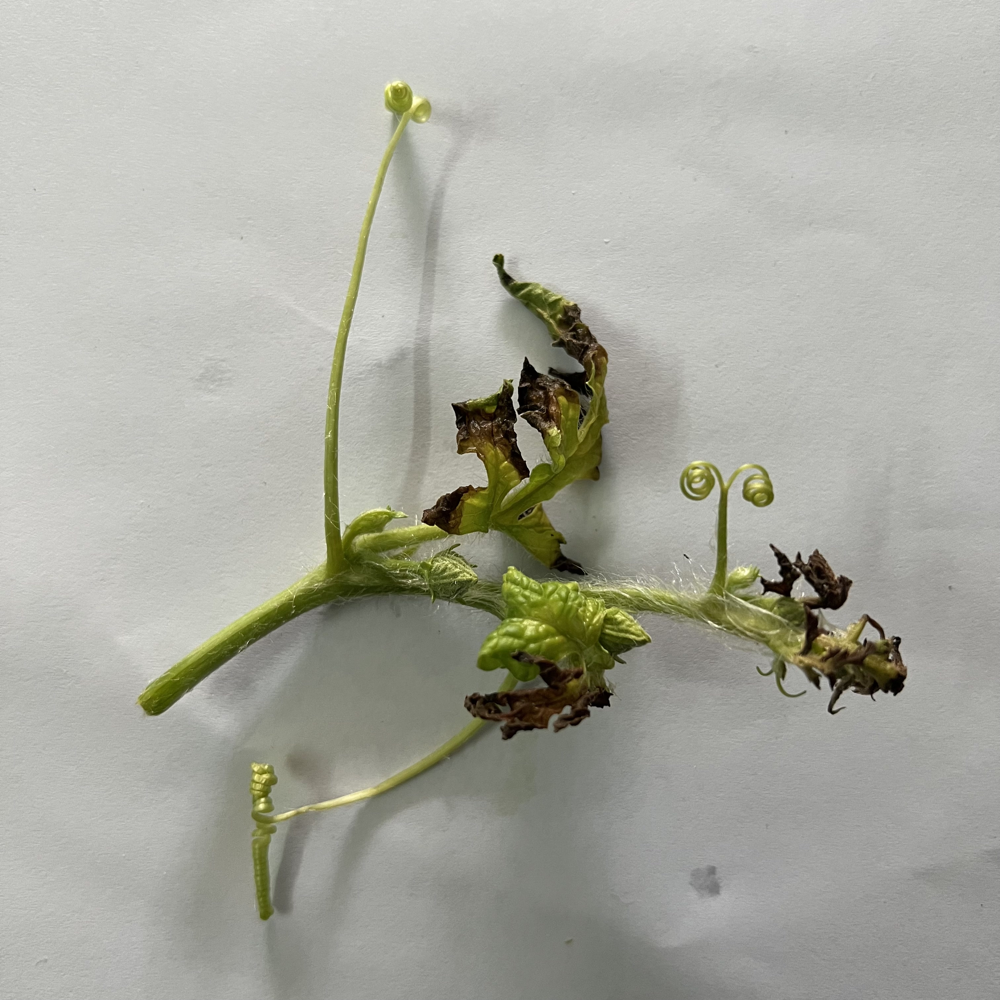

In [ ]:
dataset['train'][500]['image']

In [ ]:
print(predict(dataset['train'][500]['image']))

3


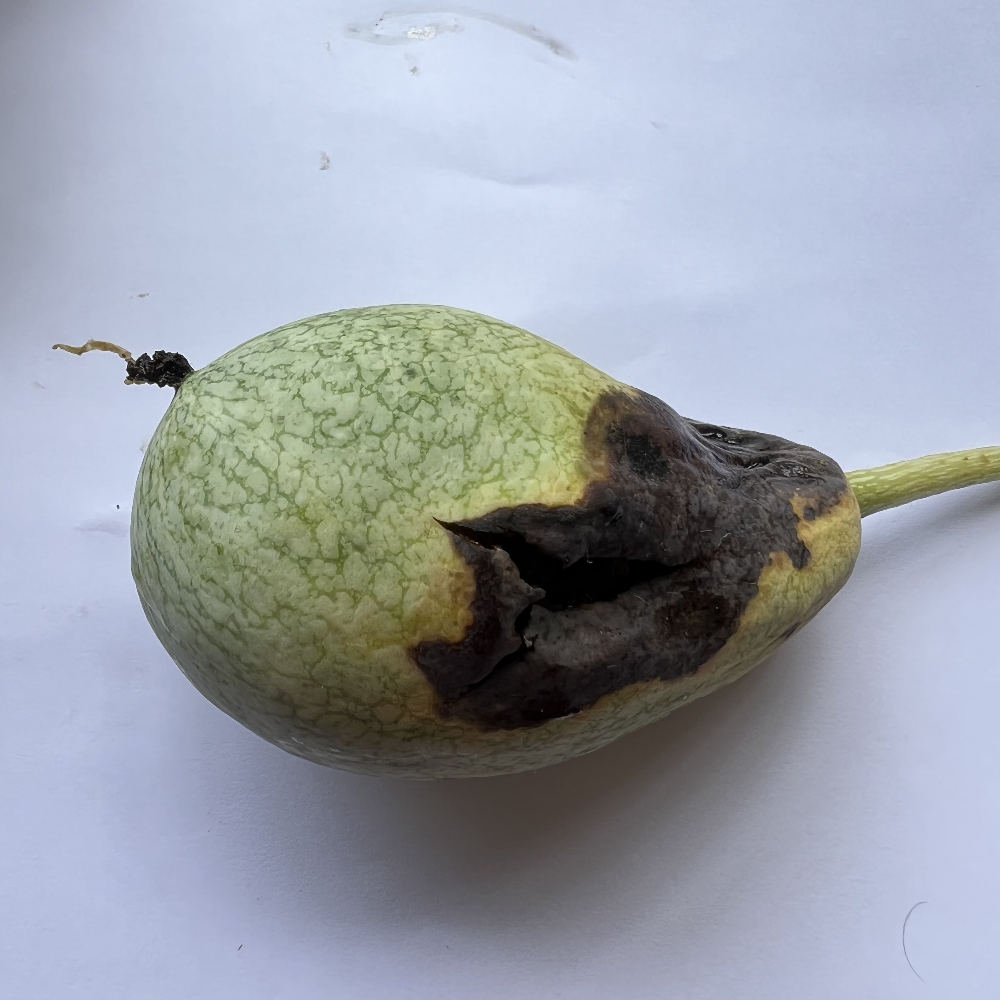

In [ ]:
dataset['train'][0]['image']

In [ ]:
print(predict(dataset['train'][0]['image']))

3


Accuracy: 0.995
Precision: 1.000
Recall: 0.995
F1 Score: 0.997
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         3
           1       1.00      1.00      1.00       152
           2       1.00      1.00      1.00       144
           3       0.99      1.00      1.00       301

    accuracy                           0.99       600
   macro avg       0.75      0.75      0.75       600
weighted avg       0.99      0.99      0.99       600



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_

<Figure size 800x600 with 0 Axes>

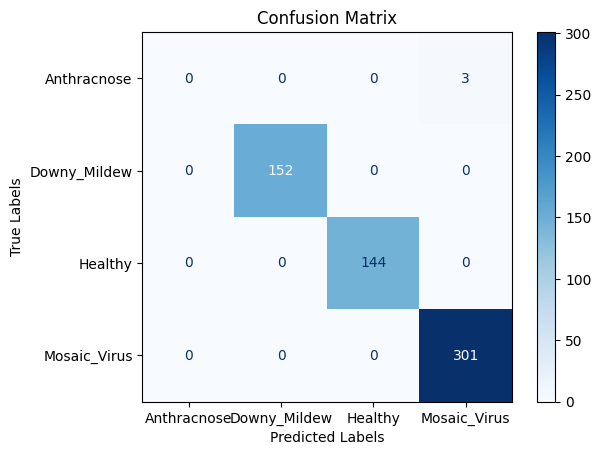

In [ ]:
import random
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

all_predictions = []
all_labels = []

for i in range(600):
  rand = (random.randint(0,802))
  all_predictions.append(dataset['train'][rand]['label'])
  all_labels.append(predict(dataset['train'][rand]['image']))

accuracy = accuracy_score(all_labels, all_predictions)
precision = precision_score(all_labels, all_predictions, average='weighted')
recall = recall_score(all_labels, all_predictions, average='weighted')
f1 = f1_score(all_labels, all_predictions, average='weighted')
conf_matrix = confusion_matrix(all_labels, all_predictions)

print(f'Accuracy: {accuracy:.3f}')
print(f'Precision: {precision:.3f}')
print(f'Recall: {recall:.3f}')
print(f'F1 Score: {f1:.3f}')



print(classification_report(all_predictions, all_labels))

confusion = confusion_matrix(all_predictions, all_labels)

# Create a ConfusionMatrixDisplay object
disp = ConfusionMatrixDisplay(confusion_matrix=confusion, display_labels=['Anthracnose', 'Downy_Mildew', 'Healthy', 'Mosaic_Virus']

)

# # Plot the confusion matrix
plt.figure(figsize=(8, 6))
disp.plot(cmap='Blues', values_format='d')

# # Set axis labels and title
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')

# # Show the plot
plt.show()


In [ ]:
from PIL import Image
import os

# Define the local path to the folder containing the grayscale images
data_folder = "/content/drive/MyDrive/Alzheimers-ADNI/test"

# Initialize a list to store all image files
image_files = []

# Recursively search for image files in all subfolders
for root, dirs, files in os.walk(data_folder):
    for file in files:
        if file.endswith('.jpg') or file.endswith('.png'):
            image_files.append(os.path.join(root, file))

# Iterate through each image file
for image_file in image_files:
    # Open the image
    with Image.open(image_file) as img:
        # Convert the image to RGB if it's grayscale
        if img.mode != 'RGB':
            img = img.convert('RGB')

        # Save the image, overwriting the original file
        img.save(image_file)

print("Conversion complete.")

Conversion complete.


In [ ]:
data_folder = "/content/drive/MyDrive/My Research/Research_Paper_Watermalon_Disease/Watermelon/"

# Load the dataset
dataset = load_dataset(data_folder)

print(dataset)

Resolving data files:   0%|          | 0/803 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['image', 'label'],
        num_rows: 803
    })
})


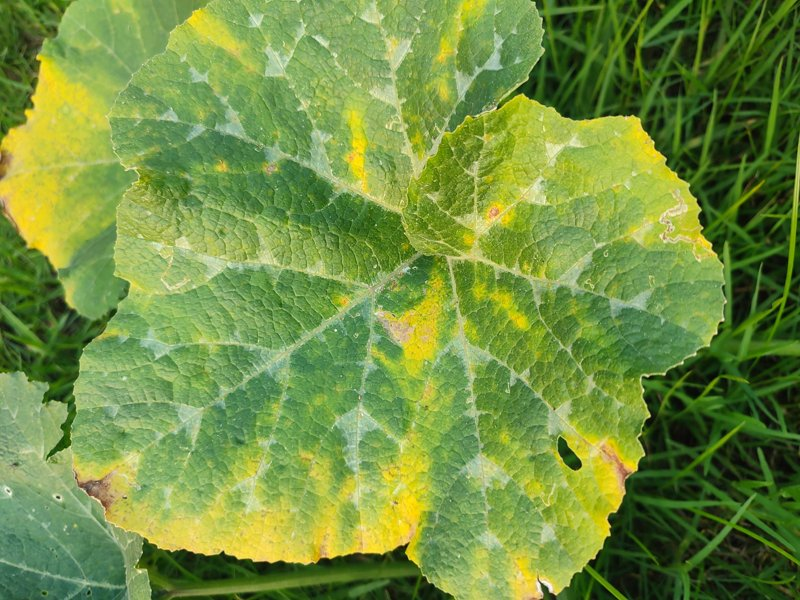

In [ ]:
dataset['train'][194]['image']

Accuracy: 0.990
Precision: 0.990
Recall: 0.990
F1 Score: 0.990
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       1.00      1.00      1.00       181
           2       1.00      1.00      1.00        11
           3       0.00      0.00      0.00         0

    accuracy                           0.99       194
   macro avg       0.50      0.50      0.50       194
weighted avg       0.99      0.99      0.99       194



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_

<Figure size 800x600 with 0 Axes>

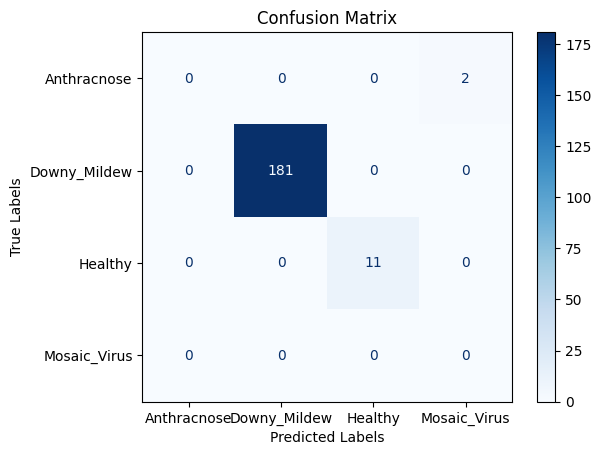

In [ ]:
import random
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

all_predictions = []
all_labels = []

for i in range(194):

  all_predictions.append(dataset['train'][i]['label'])
  all_labels.append(predict(dataset['train'][i]['image']))

accuracy = accuracy_score(all_labels, all_predictions)
precision = precision_score(all_labels, all_predictions, average='weighted')
recall = recall_score(all_labels, all_predictions, average='weighted')
f1 = f1_score(all_labels, all_predictions, average='weighted')
conf_matrix = confusion_matrix(all_labels, all_predictions)

print(f'Accuracy: {accuracy:.3f}')
print(f'Precision: {precision:.3f}')
print(f'Recall: {recall:.3f}')
print(f'F1 Score: {f1:.3f}')



print(classification_report(all_predictions, all_labels))

confusion = confusion_matrix(all_predictions, all_labels)

# Create a ConfusionMatrixDisplay object
disp = ConfusionMatrixDisplay(confusion_matrix=confusion, display_labels=['Anthracnose', 'Downy_Mildew', 'Healthy', 'Mosaic_Virus']

)

# # Plot the confusion matrix
plt.figure(figsize=(8, 6))
disp.plot(cmap='Blues', values_format='d')

# # Set axis labels and title
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')

# # Show the plot
plt.show()